In [1]:
## adding libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import nbformat
from sklearn.compose import ColumnTransformer
import seaborn as sns
# import standard scaler and train test split
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split 
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from sklearn.preprocessing import OneHotEncoder 
from sklearn.preprocessing import LabelEncoder
from xgboost import XGBClassifier as xgb
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression
import lightgbm as lgb
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_curve, auc
from sklearn.tree import DecisionTreeClassifier



In [2]:
### reading provided dataset
customer_df = pd.read_csv('../../data/raw/term-deposit-marketing-2020.csv')

In [3]:
customer_df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,y
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,no


In [4]:
customer_df.describe()  

,age,balance,day,duration,campaign
count,40000.000000,40000.000000,40000.000000,40000.000000,40000.000000
mean,40.544600,1274.277550,16.017225,254.824300,2.882175
std,9.641776,2903.769716,8.278127,259.366498,3.239051
min,19.000000,-8019.000000,1.000000,0.000000,1.000000
25%,33.000000,54.000000,8.000000,100.000000,1.000000
50%,39.000000,407.000000,17.000000,175.000000,2.000000
75%,48.000000,1319.000000,21.000000,313.000000,3.000000
max,95.000000,102127.000000,31.000000,4918.000000,63.000000


In [5]:

customer_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40000 entries, 0 to 39999
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        40000 non-null  int64 
 1   job        40000 non-null  object
 2   marital    40000 non-null  object
 3   education  40000 non-null  object
 4   default    40000 non-null  object
 5   balance    40000 non-null  int64 
 6   housing    40000 non-null  object
 7   loan       40000 non-null  object
 8   contact    40000 non-null  object
 9   day        40000 non-null  int64 
 10  month      40000 non-null  object
 11  duration   40000 non-null  int64 
 12  campaign   40000 non-null  int64 
 13  y          40000 non-null  object
dtypes: int64(5), object(9)
memory usage: 4.3+ MB


In [6]:
## day needs to be categorical
customer_df['day'] = customer_df['day'].astype('object')

In [7]:
input_features = customer_df.drop('y', axis=1)
target_variable = customer_df['y']  # assuming 'y' is the target variable

In [8]:
# Identify numerical and categorical features
numerical_features = input_features.select_dtypes(include=[np.number]).columns.tolist()
categorical_features = input_features.select_dtypes(include=['object']).columns.tolist()

In [9]:
print("Numerical Features:", numerical_features)
print("Categorical Features:", categorical_features)

Numerical Features: ['age', 'balance', 'duration', 'campaign']
Categorical Features: ['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'day', 'month']


In [10]:
# features having unknown values
categorical_features_with_unknown = []
for col in categorical_features:
    unknown_count = (input_features[col] == 'unknown').sum()
    if unknown_count > 0:
        print(f"Column '{col}' has {unknown_count} 'unknown' values.")
        categorical_features_with_unknown.append(col)

Column 'job' has 235 'unknown' values.
Column 'education' has 1531 'unknown' values.
Column 'contact' has 12765 'unknown' values.


In [11]:
## setting y to binary
target_variable = target_variable.map({'yes': 1, 'no': 0})

In [12]:
customer_df.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'y'],
      dtype='object')

In [21]:
### checking distribution of y and other features against y - plotting using plotly
fig = px.histogram(customer_df, x='y', title='Distribution of Target Variable(y)')
fig.show()
fig.write_image('../../reports/figures/distribution_of_target_variable.png')
fig = px.histogram(customer_df, x='job', color='y', barmode='group', title='Job vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/job_vs_subscription_status.png')
fig = px.histogram(customer_df, x='marital', color='y', barmode='group', title='Marital Status vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/marital_status_vs_subscription_status.png')
fig = px.histogram(customer_df, x='education', color='y', barmode='group', title='Education vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/education_vs_subscription_status.png')
fig = px.histogram(customer_df, x='default', color='y', barmode='group', title='default vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/default_vs_subscription_status.png')
fig = px.histogram(customer_df, x='balance', color='y', barmode='group', title='balance vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/balance_vs_subscription_status.png')
fig = px.histogram(customer_df, x='housing', color='y', barmode='group', title='housing vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/housing_vs_subscription_status.png')
fig = px.histogram(customer_df, x='loan', color='y', barmode='group', title='loan vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/loan_vs_subscription_status.png')   
fig = px.histogram(customer_df, x='contact', color='y', barmode='group', title='Contact Type vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/contact_type_vs_subscription_status.png')
fig = px.histogram(customer_df, x='month', color='y', barmode='group', title='Month vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/month_vs_subscription_status.png')
fig = px.histogram(customer_df, x='day', color='y', barmode='group', title='day vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/day_vs_subscription_status.png')
fig = px.histogram(customer_df, x='duration', color='y', barmode='group', title='duration vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/duration_vs_subscription_status.png')
fig = px.histogram(customer_df, x='campaign', color='y', barmode='group', title='campaign vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/campaign_vs_subscription_status.png')
fig = px.histogram(customer_df, x='age', color='y', barmode='group', title='Age vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/age_vs_subscription_status.png')



### customers likely to have subscription:
- people in the age group between 30 - 40
- month of May seems to have highest subscription
- people who are married 
- people who have secondary level of education
- who are run with campaign type 1 
- duration of call plays an important role
- customers contacted via cellular 

In [22]:
# use plotly to create interactive visualizations
for col in input_features.columns:
    fig = px.histogram(input_features, x=col, title=f'Distribution of {col}', marginal="box")
    fig.show()

In [13]:
# percentage distribution
total = len(target_variable)
percentage_yes = (target_variable.sum() / total) * 100
percentage_no = 100 - percentage_yes
print(f"Total samples: {total}")
print(f"Number of 'yes': {target_variable.sum()}")
print(f"Number of 'no': {total - target_variable.sum()}")
print(f"Percentage of 'yes': {percentage_yes:.2f}%")
print(f"Percentage of 'no': {percentage_no:.2f}%")

Total samples: 40000
Number of 'yes': 2896
Number of 'no': 37104
Percentage of 'yes': 7.24%
Percentage of 'no': 92.76%


In [14]:
## calculating class weights to handle class imbalance
from sklearn.utils.class_weight import compute_class_weight
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(target_variable), y=target_variable)
class_weight_dict = {i : class_weights[i] for i in range(len(class_weights))}
print("Class Weights:", class_weight_dict)

Class Weights: {0: np.float64(0.5390254420008624), 1: np.float64(6.906077348066298)}


-  Graph shows that the dataset is imbalanced with more customers not subscribing to term deposit than subscribing.
-  This imbalance needs to be addressed during model training using techniques like oversampling, undersampling,

In [15]:
customer_df[categorical_features].describe()

,job,marital,education,default,housing,loan,contact,day,month
count,40000,40000,40000,40000,40000,40000,40000,40000,40000
unique,12,3,4,2,2,2,3,31,11
top,blue-collar,married,secondary,no,yes,no,cellular,20,may
freq,9383,24386,20993,39191,24031,33070,24914,2655,13532


In [16]:
customer_df[categorical_features].nunique()

job          12
marital       3
education     4
default       2
housing       2
loan          2
contact       3
day          31
month        11
dtype: int64

In [17]:
monthname = ['jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec']
for month in monthname:
    print(f"{month}: {input_features[input_features['month'] == month]['month'].value_counts().get(month, 0)}")

jan: 1176
feb: 2296
mar: 258
apr: 2718
may: 13532
jun: 4734
jul: 6380
aug: 5215
sep: 0
oct: 80
nov: 3598
dec: 13


- apparently no entries for the month of september

In [36]:
## there are no entries for september
input_features['month'].unique()

array(['may', 'jun', 'jul', 'aug', 'oct', 'nov', 'dec', 'jan', 'feb',
       'mar', 'apr'], dtype=object)

#### **Feature engineering**

In [18]:
#### **Feature engineering**
# converting day to week
input_features['week'] = input_features['day'].apply(lambda x: (int(x)-1)//7 + 1)
input_features['week'].value_counts()


week
3    12887
2     8880
1     8423
4     6162
5     3648
Name: count, dtype: int64

In [19]:
# converting month to quarter
monthname = ['jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec']

# normalize month values and map to quarter
input_features['month_norm'] = input_features['month'].astype(str).str.lower()

def month_to_quarter(m):
	try:
		return (monthname.index(m) // 3) + 1
	except ValueError:
		return np.nan

input_features['quarter'] = input_features['month_norm'].map(month_to_quarter).astype('Int64')
input_features.drop(columns=['month_norm'], inplace=True)

input_features['quarter'].value_counts(dropna=False)


quarter
2    20984
3    11595
1     3730
4     3691
Name: count, dtype: Int64

In [20]:
### add week and quarter to categorical features
categorical_features.append('week')
categorical_features.append('quarter')

In [21]:
# creating new features is_high_balance and loan_count
is_high_balance = customer_df['balance'] > customer_df['balance'].median()
print(is_high_balance)
loan_count = customer_df['housing'].map({'yes':1, 'no':0}) + customer_df['loan'].map({'yes':1, 'no':0})
print(loan_count)

0         True
1        False
2        False
3         True
4        False
         ...  
39995    False
39996     True
39997    False
39998     True
39999     True
Name: balance, Length: 40000, dtype: bool
0        1
1        1
2        2
3        1
4        0
        ..
39995    0
39996    0
39997    0
39998    0
39999    1
Length: 40000, dtype: int64


In [24]:
## adding loan_count and is_high_balance to input features
input_features['is_high_balance'] = is_high_balance.astype(int)
input_features['loan_count'] = loan_count

In [32]:
## adding campaign features
input_features['campaign_intensity'] = input_features['duration'] / (input_features['campaign'] + 1)
contacted_multiple_times = input_features['campaign'] > 1
input_features['contacted_multiple_times'] = contacted_multiple_times.astype(int)
is_last_call_long = input_features['duration'] > input_features['duration'].median()
input_features['is_last_call_long'] = is_last_call_long.astype(int)
#input_features.append('contacted_multiple_times')
#input_features['campaign_intensity'].append('campaign_intensity')
#input_features['is_last_call_long'].append('is_last_call_long')

In [34]:
## adding age binning
age_bins = [0, 18, 30, 40, 50, 60, 70, 80, 100]
age_labels = ['<18', '18-29', '30-39', '40-49', '50-59', '60-69', '70-79', '80+']
input_features['age_group'] = pd.cut(input_features['age'], bins=age_bins, labels=age_labels, right=False)
#categorical_features.append('age_group')

In [35]:
input_features.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'week',
       'quarter', 'is_high_balance', 'loan_count', 'campaign_intensity',
       'contacted_multiple_times', 'is_last_call_long', 'age_group'],
      dtype='object')

In [36]:
# merge input features and target variable for plotting
customer_df_updated = pd.concat([input_features, target_variable], axis=1)

In [37]:
### weeks vs subscription status
fig = px.histogram(customer_df_updated, x='week', color='y', barmode='group', title='Week vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/week_vs_subscription_status.png')
### quarters vs subscription status
fig = px.histogram(customer_df_updated, x='quarter', color='y', barmode='group', title='Quarter vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/quarter_vs_subscription_status_featured.png')
### campaign_intensity vs subscription status
fig = px.histogram(customer_df_updated, x='campaign_intensity', color='y', barmode='group', title='Campaign Intensity vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/campaign_intensity_vs_subscription_status_featured.png')
### loan_count vs subscription status
fig = px.histogram(customer_df_updated, x='loan_count', color='y', barmode='group', title='Loan Count vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/loan_count_vs_subscription_status_featured.png')
### age_group vs subscription status
fig = px.histogram(customer_df_updated, x='age_group', color='y', barmode='group', title='Age Group vs Subscription Status')
fig.show()
fig.write_image('../../reports/figures/age_group_vs_subscription_status_featured.png')


### few important things to note about these new features with regards to customer subscription
- week 3 of month & quarter 2 seems to have highest number of subscriptions.
- people having one loan tend to get subscription.
- campaign intensity plays an important role in customer subscriptions.
- age group 30 - 39 have the highest tendency to get the subscription. 

In [38]:
input_features.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,...,duration,campaign,week,quarter,is_high_balance,loan_count,campaign_intensity,contacted_multiple_times,is_last_call_long,age_group
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,...,261,1,1,2,1,1,130.5,0,1,50-59
1,44,technician,single,secondary,no,29,yes,no,unknown,5,...,151,1,1,2,0,1,75.5,0,0,40-49
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,...,76,1,1,2,0,2,38.0,0,0,30-39
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,...,92,1,1,2,1,1,46.0,0,0,40-49
4,33,unknown,single,unknown,no,1,no,no,unknown,5,...,198,1,1,2,0,0,99.0,0,1,30-39


In [59]:
month_map = {'jan':1,'feb':2,'mar':3,'apr':4,'may':5,'jun':6,'jul':7,'aug':8,'sep':9,'oct':10,'nov':11,'dec':12}
input_features['month_num'] = input_features['month'].map(month_map)
input_features['is_quarter_end'] = input_features['month_num'].isin([3,6,9,12]).astype(int)


In [39]:
### customer segmentation features
#age_group already added

## has any loan
has_loan = ((input_features['housing'] == 'yes') | (input_features['loan'] == 'yes')).astype(int)

## education & job
education_job = input_features['education'] + "_" + input_features['job']

In [41]:
## adding new features to input_features
#input_features['age_group'] = age_group
input_features['has_loan'] = has_loan
input_features['education_job'] = education_job
input_features.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'week',
       'quarter', 'is_high_balance', 'loan_count', 'campaign_intensity',
       'contacted_multiple_times', 'is_last_call_long', 'age_group',
       'has_loan', 'education_job'],
      dtype='object')

In [42]:
## separating features again
numerical_features_updated = input_features.select_dtypes(include=[np.number]).columns.tolist()
categorical_features_updated = input_features.select_dtypes(include=['object', 'category']).columns.tolist()


In [43]:
# make sure categorical_features contains only existing columns (and keep order/uniqueness)
#categorical_features = [c for c in dict.fromkeys(categorical_features) if c in input_features.columns]
## preprocessing steps
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
binary_transformer = LabelEncoder()

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numerical_features_updated),
        ('cat', categorical_transformer, categorical_features_updated)
        #('bin', binary_transformer, binary_features)
    ]
)

In [44]:
# TRAIN / VAL / TEST SPLIT  (70 / 15 / 15)
X_train, X_temp, y_train, y_temp = train_test_split(
    input_features, target_variable, test_size=0.30, random_state=42, stratify=target_variable
)

X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.50, random_state=42, stratify=y_temp
)


In [45]:
# percentage distribution
total = len(target_variable)
# class weight of yes
cw_yes = total / (2 * target_variable.sum())
print(f"Class weight for 'yes': {cw_yes:.2f}")
# class weight of no
cw_no = total / (2 * (total - target_variable.sum()))
print(f"Class weight for 'no': {cw_no:.2f}")

Class weight for 'yes': 6.91
Class weight for 'no': 0.54


Logistic regression Classifier Results:
Accuracy score: 0.9083333333333333
Precision score: 0.4252577319587629
Recall score: 0.7603686635944701
F1 score: 0.5454545454545454
classification report:
               precision    recall  f1-score   support

           0       0.98      0.92      0.95      5566
           1       0.43      0.76      0.55       434

    accuracy                           0.91      6000
   macro avg       0.70      0.84      0.75      6000
weighted avg       0.94      0.91      0.92      6000



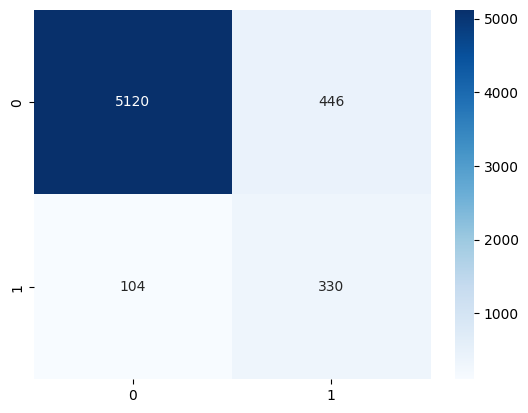

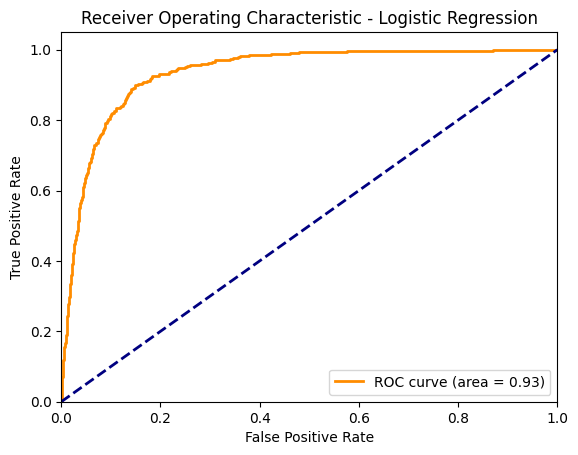

In [46]:
### train logistic regression model

# rebuild preprocessor to reflect the cleaned categorical_features
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numerical_features_updated),
        ('cat', categorical_transformer, categorical_features_updated)
    ]
)
class_weight_dict = {0: 1.0, 1: 6.0}  # keeping class weight of no as 1.0
model_lr = LogisticRegression(class_weight=class_weight_dict, max_iter=1000, random_state=42)
pipeline_lr = Pipeline(steps=[('preprocessor', preprocessor),
                              ('classifier', model_lr)])
pipeline_lr.fit(X_train, y_train)
y_pred_lr = pipeline_lr.predict(X_test)
print("Logistic regression Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_lr))
print('Precision score:', precision_score(y_test, y_pred_lr))
print('Recall score:', recall_score(y_test, y_pred_lr))
print('F1 score:', f1_score(y_test, y_pred_lr))
print('classification report:\n', classification_report(y_test, y_pred_lr))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_lr), annot=True, fmt='d', cmap='Blues')
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_lr = pipeline_lr.predict_proba(X_test)[:, 1]
fpr_lr, tpr_lr, _ = roc_curve(y_test, y_pred_proba_lr)
roc_auc_lr = auc(fpr_lr, tpr_lr)
plt.figure()
plt.plot(fpr_lr, tpr_lr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_lr)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Logistic Regression')
plt.legend(loc="lower right")
plt.show()


KNN Classifier Results:
Accuracy score: 0.9306666666666666
Precision score 0.5378151260504201
Recall score 0.29493087557603687
Confusion Matrix:
 [[5456  110]
 [ 306  128]]
classification report:
               precision    recall  f1-score   support

           0       0.95      0.98      0.96      5566
           1       0.54      0.29      0.38       434

    accuracy                           0.93      6000
   macro avg       0.74      0.64      0.67      6000
weighted avg       0.92      0.93      0.92      6000



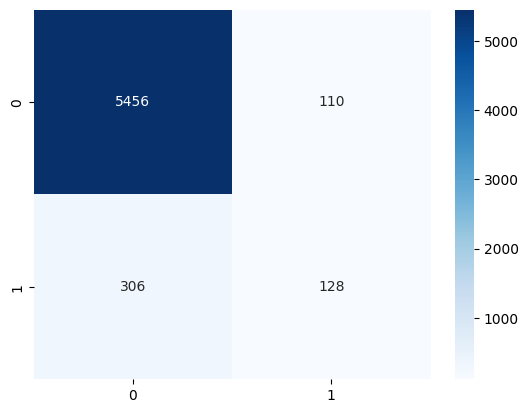

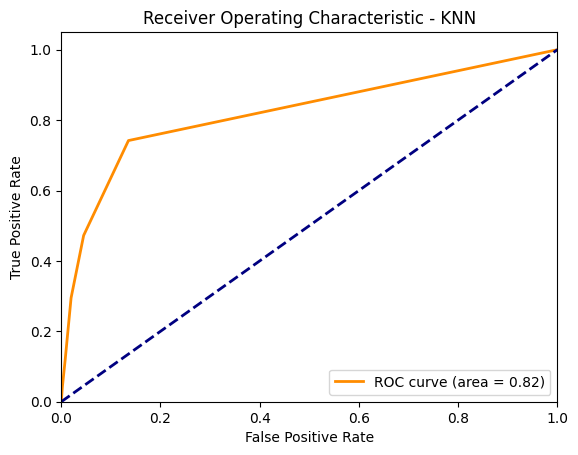

In [47]:
### using knn classifier
class_weight_dict = {0: 1.0, 1: 6} 
weight_val ='6'





model_knn = KNeighborsClassifier(weights='uniform', n_neighbors=5)
pipeline_knn = Pipeline(steps=[('preprocessor', preprocessor),
                              ('classifier', model_knn)])
pipeline_knn.fit(X_train, y_train)
y_pred_knn = pipeline_knn.predict(X_test)
print("KNN Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_knn))
print('Precision score', precision_score(y_test, y_pred_knn))
print('Recall score', recall_score(y_test, y_pred_knn))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_knn))
print('classification report:\n', classification_report(y_test, y_pred_knn))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_knn), annot=True, fmt='d', cmap='Blues')
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_knn = pipeline_knn.predict_proba(X_test)[:, 1]
fpr_knn, tpr_knn, _ = roc_curve(y_test, y_pred_proba_knn)
roc_auc_knn = auc(fpr_knn, tpr_knn)
plt.figure()
plt.plot(fpr_knn, tpr_knn, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_knn)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - KNN')
plt.legend(loc="lower right")
plt.show()


Random Forest Classifier Results:
Accuracy score: 0.9345
Precision score 0.6096256684491979
Recall score 0.2626728110599078
Confusion Matrix:
 [[5493   73]
 [ 320  114]]
classification report:
               precision    recall  f1-score   support

           0       0.94      0.99      0.97      5566
           1       0.61      0.26      0.37       434

    accuracy                           0.93      6000
   macro avg       0.78      0.62      0.67      6000
weighted avg       0.92      0.93      0.92      6000



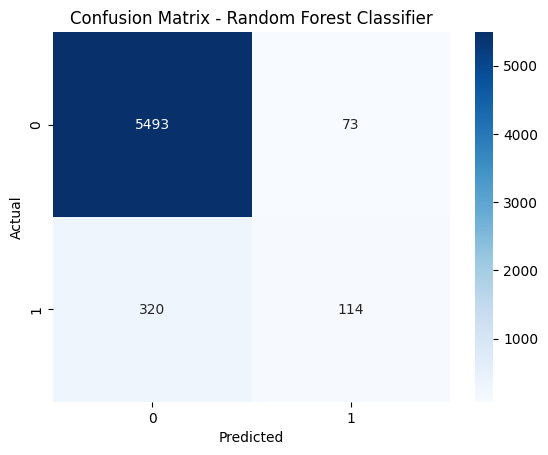

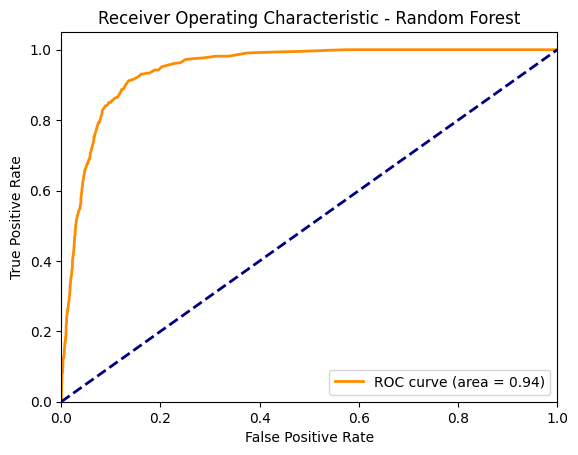

In [50]:
## train Random Forest Classifier
class_weight_dict = {0: 1.0, 1: 5}  # keeping class weight of no as 1.0
model_rf = RandomForestClassifier(n_estimators=300, random_state=42, class_weight=class_weight_dict)
pipeline_rf = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', model_rf)])
### predict the test set results
pipeline_rf.fit (X_train, y_train)
y_pred_rf = pipeline_rf.predict(X_test)
print("Random Forest Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_rf))
print('Precision score', precision_score(y_test, y_pred_rf))
print('Recall score', recall_score(y_test, y_pred_rf))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_rf))
print('classification report:\n', classification_report(y_test, y_pred_rf))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_rf), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - Random Forest Classifier')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_rf = pipeline_rf.predict_proba(X_test)[:, 1]
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_pred_proba_rf)
roc_auc_rf = auc(fpr_rf, tpr_rf)
plt.figure()
plt.plot(fpr_rf, tpr_rf, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_rf)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Random Forest')
plt.legend(loc="lower right")
plt.show()

XGBoost Classifier Results:
Accuracy score: 0.9253333333333333
Precision score 0.48588709677419356
Recall score 0.5552995391705069
Confusion Matrix:
 [[5311  255]
 [ 193  241]]
classification report:
               precision    recall  f1-score   support

           0       0.96      0.95      0.96      5566
           1       0.49      0.56      0.52       434

    accuracy                           0.93      6000
   macro avg       0.73      0.75      0.74      6000
weighted avg       0.93      0.93      0.93      6000



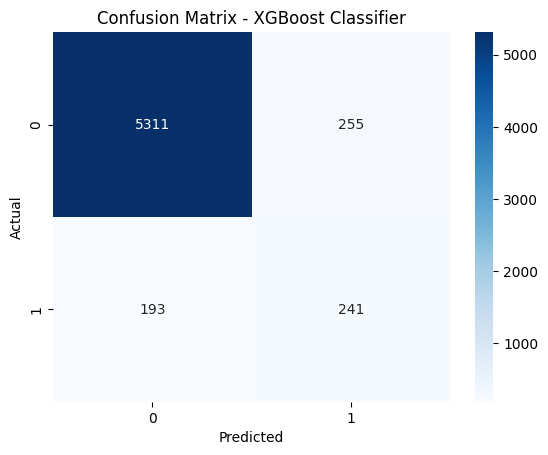

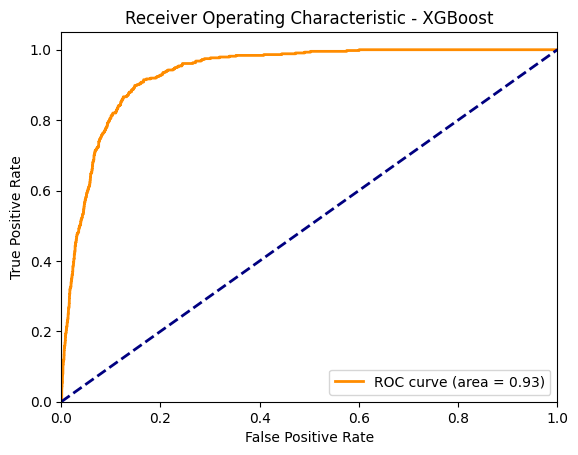

In [51]:
## train xgboost Classifier
model_xgb = xgb(n_estimators=300, random_state=42, scale_pos_weight=6,
                max_depth=6)
pipeline_xgb = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', model_xgb)])
### predict the test set results
pipeline_xgb.fit (X_train, y_train)
y_pred_xgb = pipeline_xgb.predict(X_test)
print("XGBoost Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_xgb))
print('Precision score', precision_score(y_test, y_pred_xgb))
print('Recall score', recall_score(y_test, y_pred_xgb))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_xgb))
print('classification report:\n', classification_report(y_test, y_pred_xgb))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_xgb), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - XGBoost Classifier')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_xgb = pipeline_xgb.predict_proba(X_test)[:, 1]
fpr_xgb, tpr_xgb, _ = roc_curve(y_test, y_pred_proba_xgb)
roc_auc_xgb = auc(fpr_xgb, tpr_xgb)
plt.figure()
plt.plot(fpr_xgb, tpr_xgb, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_xgb)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - XGBoost')
plt.legend(loc="lower right")
plt.show()

[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Info] Number of positive: 2027, number of negative: 25973
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003990 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1135
[LightGBM] [Info] Number of data points in the train set: 28000, number of used features: 132
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.318920 -> initscore=-0.758741
[LightGBM] [Info] Start training from score -0.758741
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

c:\Users\My-PC\miniconda3\envs\data_analysis\lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but LGBMClassifier was fitted with feature names



[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
LightGBM Classifier Results:
Accuracy score: 0.9191666666666667
Precision score 0.462882096069869
Recall score 0.7327188940092166
Confusion Matrix:
 [[5197  369]
 [ 116  318]]
classification report:
               precision    recall  f1-score   support

           0       0.98      0.93      0.96      5566
           1       0.46      0.73      0.57       434

    accuracy                           0.92      6000
   macro avg       0.72      0.83      0.76      6000
weighted avg       0.94      0.92      0.93      6000



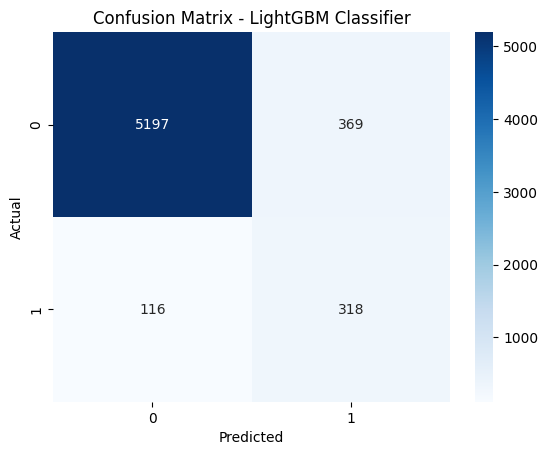

c:\Users\My-PC\miniconda3\envs\data_analysis\lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but LGBMClassifier was fitted with feature names



[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20


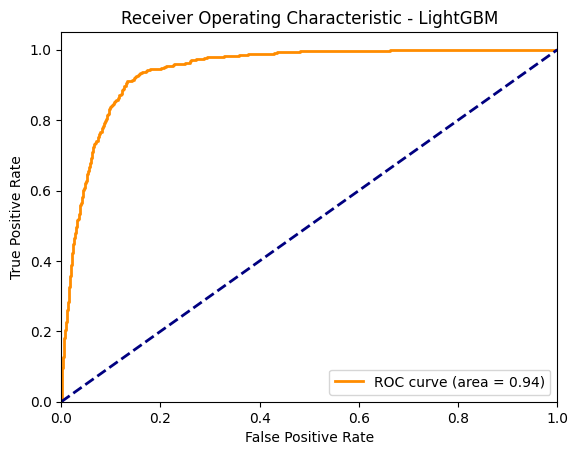

In [101]:
### using lightgbm classifier
import lightgbm as lgb
class_weight_dict = {0: 1.0, 1: 6}  # keeping class weight of no as 1.0
model_lgb = lgb.LGBMClassifier(n_estimators=300, random_state=42
, class_weight=class_weight_dict, max_depth=6, num_leaves=31, min_data_in_leaf=20, min_split_gain=0.0)
pipeline_lgb = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', model_lgb)])
### predict the test set results
pipeline_lgb.fit (X_train, y_train)
y_pred_lgb = pipeline_lgb.predict(X_test)
print("LightGBM Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_lgb))
print('Precision score', precision_score(y_test, y_pred_lgb))
print('Recall score', recall_score(y_test, y_pred_lgb))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_lgb))
print('classification report:\n', classification_report(y_test, y_pred_lgb))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_lgb), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - LightGBM Classifier')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_lgb = pipeline_lgb.predict_proba(X_test)[:, 1]
fpr_lgb, tpr_lgb, _ = roc_curve(y_test, y_pred_proba_lgb)
roc_auc_lgb = auc(fpr_lgb, tpr_lgb)
plt.figure()
plt.plot(fpr_lgb, tpr_lgb, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_lgb)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - LightGBM')
plt.legend(loc="lower right")
plt.show()





In [91]:
len(input_features.columns)

23

Decision Tree Classifier Results:
Accuracy score: 0.8961666666666667
Precision score 0.3917525773195876
Recall score 0.7880184331797235
Confusion Matrix:
 [[5035  531]
 [  92  342]]
classification report:
               precision    recall  f1-score   support

           0       0.98      0.90      0.94      5566
           1       0.39      0.79      0.52       434

    accuracy                           0.90      6000
   macro avg       0.69      0.85      0.73      6000
weighted avg       0.94      0.90      0.91      6000



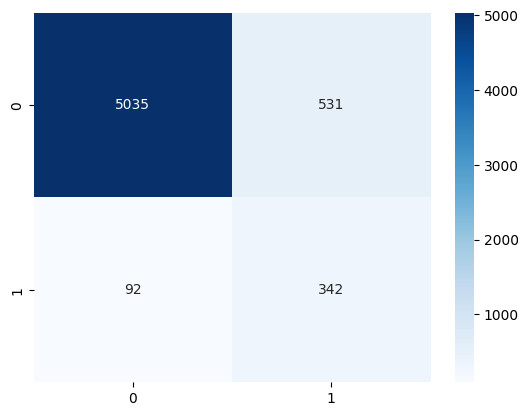

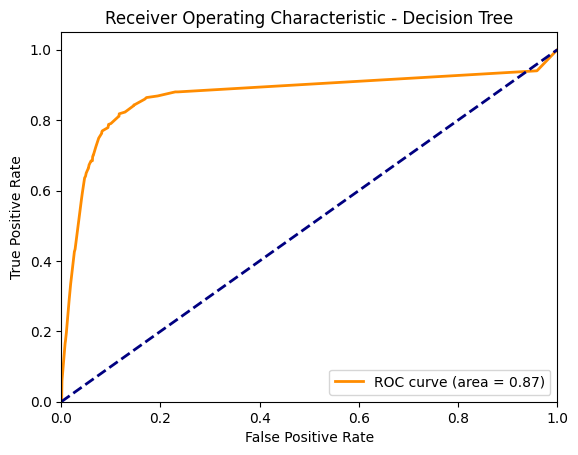

In [104]:
### using decision tree classifier
class_weight_dict = {0: 1.0, 1: 6}  # keeping class weight of no as 1.0
model_dt = DecisionTreeClassifier(random_state=42, class_weight=class_weight_dict,max_depth=8)
pipeline_dt = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', model_dt)])
pipeline_dt.fit(X_train, y_train)
y_pred_dt = pipeline_dt.predict(X_test)
print("Decision Tree Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_dt))
print('Precision score', precision_score(y_test, y_pred_dt))
print('Recall score', recall_score(y_test, y_pred_dt))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_dt))
print('classification report:\n', classification_report(y_test, y_pred_dt))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_dt), annot=True, fmt='d', cmap='Blues')
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_dt = pipeline_dt.predict_proba(X_test)[:, 1]
fpr_dt, tpr_dt, _ = roc_curve(y_test, y_pred_proba_dt)
roc_auc_dt = auc(fpr_dt, tpr_dt)
plt.figure()
plt.plot(fpr_dt, tpr_dt, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_dt)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - Decision Tree')
plt.legend(loc="lower right")
plt.show()

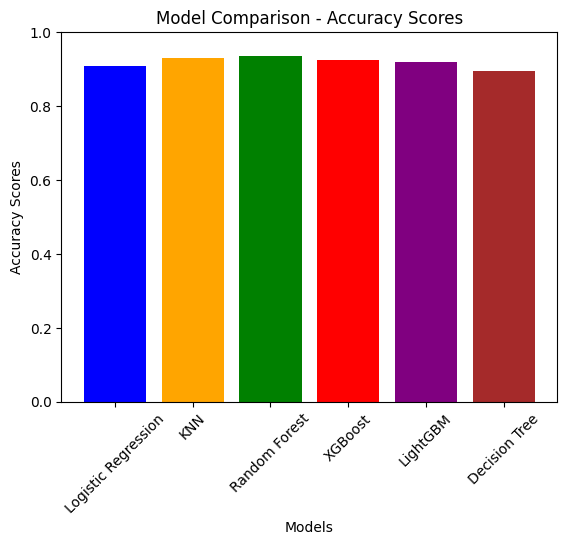

In [105]:
# comparing different model performance
models = ['Logistic Regression', 'KNN', 'Random Forest', 'XGBoost', 'LightGBM', 'Decision Tree']
accuracy_scores = [accuracy_score(y_test, y_pred_lr),
                   accuracy_score(y_test, y_pred_knn),
                   accuracy_score(y_test, y_pred_rf),
                   accuracy_score(y_test, y_pred_xgb),
                   accuracy_score(y_test, y_pred_lgb),
                   accuracy_score(y_test, y_pred_dt)]
f1_scores = [f1_score(y_test, y_pred_lr),
             f1_score(y_test, y_pred_knn),
             f1_score(y_test, y_pred_rf),
             f1_score(y_test, y_pred_xgb),
             f1_score(y_test, y_pred_lgb),
             f1_score(y_test, y_pred_dt)]
import matplotlib.pyplot as plt
plt.bar(models, accuracy_scores, color=['blue', 'orange', 'green', 'red', 'purple', 'brown'])
#plt.bar(models, f1_scores, color=['cyan', 'lightgreen', 'lightcoral', 'violet', 'pink', 'tan'], alpha=0.5)
plt.xlabel('Models')
plt.ylabel('Accuracy Scores')
plt.title('Model Comparison - Accuracy Scores')
plt.ylim(0, 1.0)
plt.xticks(rotation=45)
plt.show()



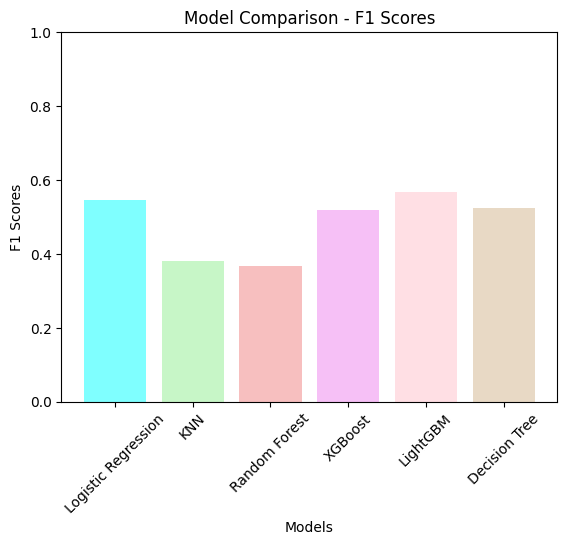

In [106]:
plt.bar(models, f1_scores, color=['cyan', 'lightgreen', 'lightcoral', 'violet', 'pink', 'tan'], alpha=0.5)
plt.xlabel('Models')
plt.ylabel('F1 Scores')
plt.title('Model Comparison - F1 Scores')
plt.ylim(0, 1.0)
plt.xticks(rotation=45)
plt.show()


In [107]:
## plotting using plotly accuracy scores & f1 scores
# comparing different model performance
models = ['Logistic Regression', 'KNN', 'Random Forest', 'XGBoost', 'LightGBM', 'Decision Tree']
fig = px.bar(x=models, y=accuracy_scores, labels={'x':'Models', 'y':'Accuracy Scores'},
             title='Model Comparison - Accuracy Scores')
#fig = px.bar(x=models, y=f1_scores, labels={'x':'Models', 'y':'F1 Scores'},
             #title='Model Comparison - F1 Scores')
fig.show()
fig.write_image('../../reports/figures/model_comparison_accuracy_scores.png')

In [108]:
## plotting using plotly accuracy scores & f1 scores

fig = px.bar(x=models, y=f1_scores, labels={'x':'Models', 'y':'F1 Scores'},
             title='Model Comparison - F1 Scores',color_discrete_sequence=px.colors.sequential.Viridis)
fig.show()
fig.write_image('../../reports/figures/model_comparison_f1_scores.png')

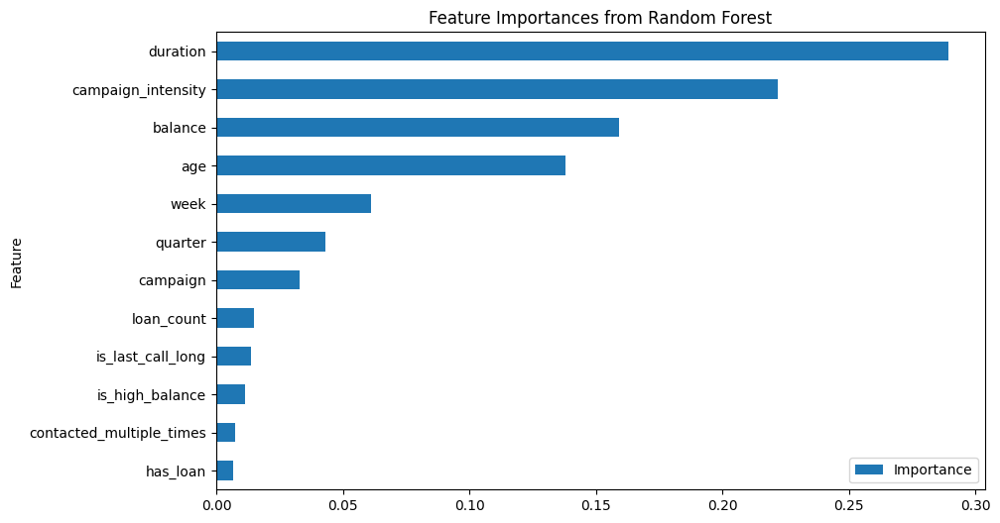

<Figure size 640x480 with 0 Axes>

In [109]:
### feature selection using random forest
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(input_features.select_dtypes(include=[np.number]), target_variable)
importances = rf.feature_importances_
importances_df = pd.DataFrame({'Feature': input_features.select_dtypes(include=[np.number]).columns, 'Importance': importances})
importances_df = importances_df.sort_values(by='Importance', ascending=False)
importances_df.head(15).sort_values(by='Importance', ascending=True).plot(kind='barh', x='Feature', y='Importance', figsize=(10,6), title='Feature Importances from Random Forest')
plt.show()
##save feature importance plot
plt.savefig('../../reports/figures/feature_importances_random_forest.png')



In [111]:
# importance of top 6 features
print(importances_df.head(6))


              Feature  Importance
2            duration    0.289395
8  campaign_intensity    0.221897
1             balance    0.159224
0                 age    0.138029
4                week    0.061306
5             quarter    0.043303


- duration of call, campain_intensity, balance , age of customer, month & week of month are some important features to focus on

In [112]:
### remove features with low importance
low_importance_features = importances_df[importances_df['Importance'] < 0.01]['Feature'].tolist()
print("Low importance features to be removed:", low_importance_features)

Low importance features to be removed: ['contacted_multiple_times', 'has_loan']


In [113]:
input_features_reduced = input_features.drop(columns=low_importance_features)
input_features_reduced.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day', 'month', 'duration', 'campaign', 'week',
       'quarter', 'is_high_balance', 'loan_count', 'campaign_intensity',
       'is_last_call_long', 'age_group', 'education_job'],
      dtype='object')

In [114]:
updated_numerical_features_2 = input_features_reduced.select_dtypes(include=[np.number]).columns.tolist()
updated_categorical_features_2 = input_features_reduced.select_dtypes(include=['object', 'category']).columns.tolist()

In [115]:

## preprocessing steps with updated features
numeric_transformer = StandardScaler()
categorical_transformer = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
binary_transformer = LabelEncoder()

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, updated_numerical_features_2),
        ('cat', categorical_transformer, updated_categorical_features_2)
        #('bin', binary_transformer, binary_features)
    ]
)

[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Info] Number of positive: 2027, number of negative: 25973
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1129
[LightGBM] [Info] Number of data points in the train set: 28000, number of used features: 130
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.318920 -> initscore=-0.758741
[LightGBM] [Info] Start training from score -0.758741


c:\Users\My-PC\miniconda3\envs\data_analysis\lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but LGBMClassifier was fitted with feature names



[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
LightGBM Classifier Results:
Accuracy score: 0.9201666666666667
Precision score 0.46500777604976673
Recall score 0.6889400921658986
Confusion Matrix:
 [[5222  344]
 [ 135  299]]
classification report:
               precision    recall  f1-score   support

           0       0.97      0.94      0.96      5566
           1       0.47      0.69      0.56       434

    accuracy                           0.92      6000
   macro avg       0.72      0.81      0.76      6000
weighted avg       0.94      0.92      0.93      6000



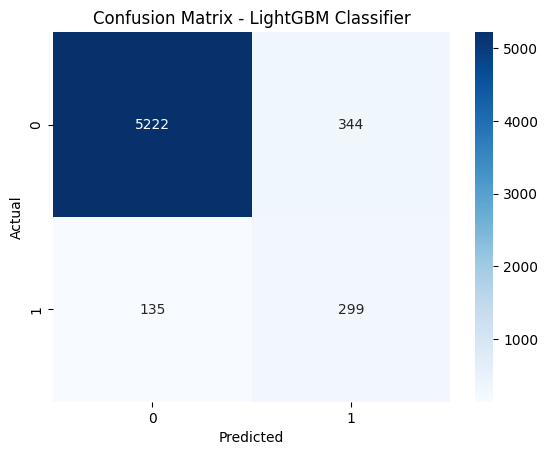

c:\Users\My-PC\miniconda3\envs\data_analysis\lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but LGBMClassifier was fitted with feature names



[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20


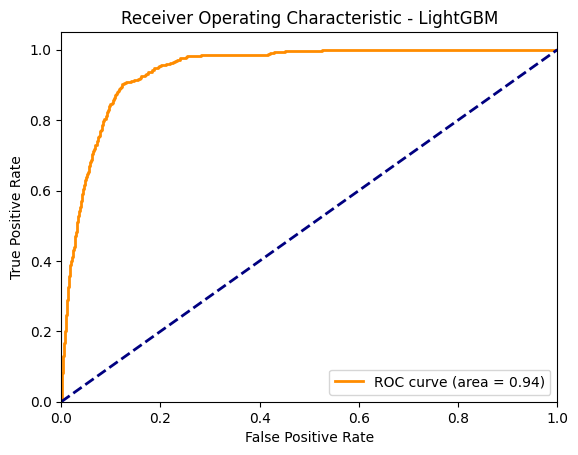

In [121]:
### using lightgbm classifier
import lightgbm as lgb
class_weight_dict = {0: 1.0, 1: 6}  # keeping class weight of no as 1.0
model_lgb = lgb.LGBMClassifier(n_estimators=300, random_state=42
, class_weight=class_weight_dict, max_depth=-1, num_leaves=31, min_data_in_leaf=20, min_split_gain=0.0)
pipeline_lgb = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', model_lgb)])
### predict the test set results
pipeline_lgb.fit (X_train, y_train)
y_pred_lgb = pipeline_lgb.predict(X_test)
print("LightGBM Classifier Results:")
print('Accuracy score:', accuracy_score(y_test, y_pred_lgb))
print('Precision score', precision_score(y_test, y_pred_lgb))
print('Recall score', recall_score(y_test, y_pred_lgb))
print('Confusion Matrix:\n', confusion_matrix(y_test, y_pred_lgb))
print('classification report:\n', classification_report(y_test, y_pred_lgb))
## plot confusion matrix
sns.heatmap(confusion_matrix(y_test, y_pred_lgb), annot=True, fmt='d', cmap='Blues')
plt.title('Confusion Matrix - LightGBM Classifier')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()
## ROC & AUC
from sklearn.metrics import roc_curve, auc
y_pred_proba_lgb = pipeline_lgb.predict_proba(X_test)[:, 1]
fpr_lgb, tpr_lgb, _ = roc_curve(y_test, y_pred_proba_lgb)
roc_auc_lgb = auc(fpr_lgb, tpr_lgb)
plt.figure()
plt.plot(fpr_lgb, tpr_lgb, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_lgb)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic - LightGBM')
plt.legend(loc="lower right")
plt.show()



